In [1]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from src.leachSFtree import leachSFClusteringJoin, leachSFClusteringTreeJoin
from src.mst_prim import prim_mst, create_routes_dict
import src.util as util
import src.topology as topology
import networkx as nx
from src.nova_join import OperatorType, NovaSolver
from src.cardinalities import create_unique_n_tuples, create_adjacency_matrix_from_pairs, generate_random_integer_dict
from src.topology import create_topologies_from_dict
import timeit
from matplotlib.ticker import FuncFormatter
import random
from src.baselines import sink_based_placement, source_based_placement, top_c
from src.eval_tools import *

## Topology Setup

In [2]:
seed = 10

topology_sizes = [100, 1000, 10000, 20000, 100000, 500000, 1000000]
worker_capacity = (1, 200)
source_capacity = (1, 5)
source_frac = 0.2
coord_cols = ["x", "y"]

X_dim = [-5000, 5000]
Y_dim = [-6000, 6000]
centers = 100
clustering = False

In [3]:
# create coordinates and capacities
coord_dict = dict()
for t_size in topology_sizes:
    coords_df = topology.coords_sim(t_size, centers, X_dim, Y_dim, seed)
    coord_dict[t_size] = coords_df

topologies_dict = create_topologies_from_dict(coord_dict, coord_cols, worker_capacity=worker_capacity,
                                              source_capacity=source_capacity, source_frac=source_frac,
                                              with_clustering=clustering,
                                              seed=seed)

Creating df for 100
Creating df for 1000
Creating df for 10000
Creating df for 20000
Creating df for 100000
Creating df for 500000
Creating df for 1000000
Done


In [4]:
topologies_dict.keys()

dict_keys([100, 1000, 10000, 20000, 100000, 500000, 1000000])

In [10]:
# Create the join matrix
input_range = [1, 125]
output_range = [1, 200]
cardinality_dicts = dict()

for t_size, vals in topologies_dict.items():
    print(f"Generating join matrix for topology {t_size}")
    prim_df, base_col, capacity_columns = topologies_dict[t_size]

    # set capacities
    source_indices = list(prim_df[prim_df["type"] == "SOURCE"].index.values)
    sink_capacity = len(source_indices) * 5
    prim_df.loc[prim_df[prim_df["type"] == "SINK"].index, capacity_columns] = sink_capacity + 0.2 * sink_capacity

    total_sum_sources = (np.mean(input_range) * len(source_indices))
    source_cardinalities = generate_random_integer_dict(source_indices, total_sum_sources, input_range[0],
                                                        input_range[1], seed=seed)
    join_pairs, unassigned = create_unique_n_tuples(source_indices, 2, shuffle=False)
    join_matrix, required = create_adjacency_matrix_from_pairs(prim_df.shape[0], join_pairs, output_range,
                                                               output_sum=sink_capacity, seed=seed, with_df=False)
    cardinality_dicts[t_size] = ({1: source_cardinalities, 2: (join_matrix, join_pairs)})
    print(f"Required resources topology={t_size} for sinks:{required}")

Generating join matrix for topology 100
Generating n=20 random integers between 1 and 125, sum=1260.0
Generating n=10 random integers between 1 and 200, sum=100
Required resources topology=100 for sinks:100
Generating join matrix for topology 1000
Generating n=200 random integers between 1 and 125, sum=12600.0
Generating n=100 random integers between 1 and 200, sum=1000
Required resources topology=1000 for sinks:1000
Generating join matrix for topology 10000
Generating n=2000 random integers between 1 and 125, sum=126000.0
Generating n=1000 random integers between 1 and 200, sum=10000
Required resources topology=10000 for sinks:10000
Generating join matrix for topology 20000
Generating n=4000 random integers between 1 and 125, sum=252000.0
Generating n=2000 random integers between 1 and 200, sum=20000
Required resources topology=20000 for sinks:20000
Generating join matrix for topology 100000
Generating n=20000 random integers between 1 and 125, sum=1260000.0
Generating n=10000 random 

### Create Logical Plan

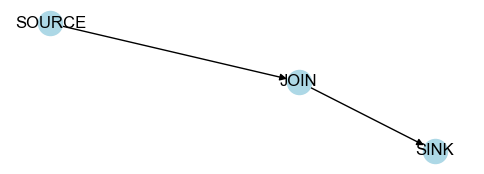

In [11]:
fig, (ax1) = plt.subplots(1, 1, figsize=(6, 2))

# Create a graph
logical_plan = nx.DiGraph()

# Add nodes with labels as attributes
logical_plan.add_node(1, type=OperatorType.SOURCE)
logical_plan.add_node(2, type=OperatorType.JOIN)
logical_plan.add_node(3, type=OperatorType.SINK)

# Add edges between nodes
logical_plan.add_weighted_edges_from([(1, 2, 1), (2, 3, 1)])

# Draw the graph
pos = nx.nx_agraph.graphviz_layout(logical_plan, prog='neato')
nx.draw(logical_plan, pos, ax=ax1, with_labels=False, arrows=True, node_color='lightblue')

# Extract the labels from node attributes
labels = nx.get_node_attributes(logical_plan, 'type')

# Draw the labels on the graph
nx.draw_networkx_labels(logical_plan, pos, labels)

# Show the plot
plt.show()

## Nova

In [7]:
reduction_fac = 0.4

df_stats = None
nova_placements = {}

In [8]:
nova_full_runtimes_dict = {}
nova_add_sources_runtimes_dict = {}
nova_remove_sources_runtimes_dict = {}
nova_remove_parents_runtimes_dict = {}
nova_update_coords_runtimes_dict = {}

re_opt_rounds = 1
for t_size, vals in topologies_dict.items():
    prim_df, base_col, capacity_columns = topologies_dict[t_size]
    cardinality_dict = cardinality_dicts[t_size]
    pdf = prim_df.copy()
    nova = NovaSolver(pdf, logical_plan, cardinality_dict=cardinality_dict, coord_cols=coord_cols,
                      reduction_fac=reduction_fac,
                      capacity_col=base_col, use_weight=False, pre_knn=True, k_resources=200)

    print("Running Nova", t_size)
    start_time = timeit.default_timer()
    df_nova_it, rep_plan_it, rel_positions_it, placement_it = nova.nova_full()
    elapsed = timeit.default_timer() - start_time
    print(f"Finished Nova {t_size} in {elapsed} seconds")
    nova_full_runtimes_dict[t_size] = elapsed

    # re-placement
    print("Recalc")
    resource_limits = []
    reopt_levels = []

    nova_source_remove = []
    nova_parent_remove = []
    nova_calc_coords = []
    nova_source_add = []

    for re_run in range(0, re_opt_rounds):
        source_nodes = set(df_nova_it[df_nova_it['type'] == 'SOURCE'].index)
        worker_nodes = set(df_nova_it[df_nova_it['type'] == 'WORKER'].index)
        parents = {int(tup[0]) for sublist in df_nova_it['parent'].tolist() for tup in sublist}
        pure_source_nodes = source_nodes.difference(parents)
        pure_parent_nodes = parents.intersection(worker_nodes)

        # remove source node
        l_idx = pure_source_nodes.pop()
        print("removing source", l_idx)
        start_time = timeit.default_timer()
        nova.remove_node(l_idx)
        elapsed = timeit.default_timer() - start_time
        nova_source_remove.append(elapsed)

        # remove parent
        p_idx = pure_parent_nodes.pop()
        print("removing parent", p_idx)
        start_time = timeit.default_timer()
        nova.remove_node(p_idx)
        elapsed = timeit.default_timer() - start_time
        nova_parent_remove.append(elapsed)

        # calc coordinates of a new node
        n_size = 50
        print("calculating new coordinates with k=", n_size)
        neighbours = random.sample(df_nova_it.index.tolist(), n_size)
        neigh_coords = df_nova_it.loc[neighbours, ["x", "y"]].to_numpy()
        latencies = np.random.randint(1, 1000, size=n_size)

        start_time = timeit.default_timer()
        n_coords, error = util.get_coords(neigh_coords, latencies)
        elapsed = timeit.default_timer() - start_time
        nova_calc_coords.append(elapsed)

        # add new source
        # Initialize a new dense array with entries all set to 0
        print("creating new node")
        join_matrix, join_pairs = cardinality_dict[2]
        join_node = pure_source_nodes.pop()
        join_dict = {join_node: random.randint(1, 10)}
        # print("Indices:", adj_list.sp_index.indices.tolist(), "Values:", adj_list.sp_values)
        value_dict = {"x": random.randint(int(X_dim[0]), int(X_dim[1])),
                      "y": random.randint(int(Y_dim[0]), int(Y_dim[1])), "capacity": prim_df[base_col].mean(),
                      "type": "SOURCE", "weight": 1}

        print("adding new node", value_dict)
        start_time = timeit.default_timer()
        df_nova_it, rep_plan_it, rel_positions_it, placement_it = nova.add_node(value_dict, join_dict)
        elapsed = timeit.default_timer() - start_time
        nova_source_add.append(elapsed)

    nova_add_sources_runtimes_dict[t_size] = np.mean(nova_source_add)
    nova_remove_sources_runtimes_dict[t_size] = np.mean(nova_source_remove)
    nova_remove_parents_runtimes_dict[t_size] = np.mean(nova_parent_remove)
    nova_update_coords_runtimes_dict[t_size] = np.mean(nova_calc_coords)

Initializing NEMO for 101
Creating kNN index
Finished kNN index
Running NEMO 100
Running NEMO on capacity_inf
Resolving pinned operators
Resolving join operators
Preparing nodes and edges
Initializing coordinates
Computing relaxed positions for n=31 nodes
Relaxed positions: 31
Replicas for 1:20
Replication count for upstream operators to 1 -> 0
Replicas for 2:10
Distributing finished: operator_id=102 (1, 2) to n=1, opt=[-622.5969628652729, -2782.6989827644434], upstream_nodes=[34], additional load=0.0
Distributing finished: operator_id=103 (3, 4) to n=1, opt=[2132.8464395395913, 330.56738959180274], upstream_nodes=[98], additional load=0.0
Distributing finished: operator_id=104 (5, 6) to n=1, opt=[-199.65993611802932, -1187.829518919322], upstream_nodes=[30], additional load=0.0
Distributing finished: operator_id=105 (7, 8) to n=1, opt=[1867.3401148908188, -4606.250253930753], upstream_nodes=[45], additional load=0.0
Distributing finished: operator_id=106 (9, 10) to n=1, opt=[837.42756

In [10]:
print("nova_full_runtimes_dict=", nova_full_runtimes_dict)
print("nova_add_sources_runtimes_dict=", nova_add_sources_runtimes_dict)
print("nova_remove_sources_runtimes_dict=", nova_remove_sources_runtimes_dict)
print("nova_remove_parents_runtimes_dict=", nova_remove_parents_runtimes_dict)
print("nova_update_coords_runtimes_dict=", nova_update_coords_runtimes_dict)

nemo_full_runtimes_dict= {100: 0.014732575999005348, 1000: 0.1290577489999123, 10000: 1.2941163649993541, 20000: 2.5077753299992764, 100000: 12.996152026000345, 500000: 68.17929167399961, 1000000: 134.61415520900118}
nemo_add_sources_runtimes_dict= {100: np.float64(0.003950594000343699), 1000: np.float64(0.004131045998292393), 10000: np.float64(0.005199297998842667), 20000: np.float64(0.006797576001190464), 100000: np.float64(0.01772864899976412), 500000: np.float64(0.09750244399947405), 1000000: np.float64(0.19904802400014887)}
nemo_remove_sources_runtimes_dict= {100: np.float64(0.0011685429999488406), 1000: np.float64(0.0008933099998102989), 10000: np.float64(0.0012646840004890691), 20000: np.float64(0.0015686179995100247), 100000: np.float64(0.004214817001411575), 500000: np.float64(0.026117080999028985), 1000000: np.float64(0.038443112000095425)}
nemo_remove_parents_runtimes_dict= {100: np.float64(0.0015112170003703795), 1000: np.float64(0.006545594000272104), 10000: np.float64(0.0

## Tree - Placement at intersections 

In [106]:
tree_full_runtimes_dict = {}

for t_size, vals in topologies_dict.items():
    prim_df, base_col, capacity_columns = topologies_dict[t_size]

    print("Running Tree", t_size)
    start_time = timeit.default_timer()

    mst_coords = prim_df[coord_cols].apply(lambda row: tuple(row), axis=1).to_dict()
    print("Creating routes")
    mst = prim_mst(mst_coords, root=0)
    routes = create_routes_dict(mst)

    elapsed = timeit.default_timer() - start_time
    print(f"Finished Tree {t_size} in {elapsed} seconds")
    tree_full_runtimes_dict[t_size] = elapsed

Running Tree 20000
Creating routes
Finished Tree 20000 in 162.60600632600108 seconds


In [107]:
tree_full_runtimes_dict

{20000: 162.60600632600108}

## Clustering - Placement at intersecting Centroids

In [108]:
cl_sf_full_runtimes_dict = {}

for t_size, vals in topologies_dict.items():
    prim_df, base_col, capacity_columns = topologies_dict[t_size]
    df = prim_df.copy()
    num_leach_clusters = max(4, int(0.1 * prim_df.shape[0]))

    print("Running CL-sf", t_size)
    start_time = timeit.default_timer()

    df_cl_join, ch_indices, centers, u = leachSFClusteringJoin(df, base_col, num_leach_clusters)

    elapsed = timeit.default_timer() - start_time
    print(f"Finished CL-sf {t_size} in {elapsed} seconds")
    cl_sf_full_runtimes_dict[t_size] = elapsed

Running CL-SF 20000
Finished CL-SF 20000 in 458.96327181499873 seconds


In [109]:
cl_sf_full_runtimes_dict

{20000: 458.96327181499873}

## Clustering+Tree - Placement at Intersecting Trees

In [110]:
cl_tree_sf_full_runtimes_dict = {}

for t_size, vals in topologies_dict.items():
    prim_df, base_col, capacity_columns = topologies_dict[t_size]
    df = prim_df.copy()
    num_leach_clusters = max(4, int(0.1 * prim_df.shape[0]))

    print("Running CL-tree-sf", t_size)
    start_time = timeit.default_timer()

    df_clTree, ch_indices, centers, u = leachSFClusteringTreeJoin(df, base_col, num_leach_clusters, coord_cols)

    elapsed = timeit.default_timer() - start_time
    print(f"Finished CL-tree-sf {t_size} in {elapsed} seconds")
    cl_tree_sf_full_runtimes_dict[t_size] = elapsed

Running CL-Tree-SF 20000
Finished CL-Tree-SF 20000 in 630.5913501639989 seconds


In [111]:
cl_tree_sf_full_runtimes_dict

{20000: 630.5913501639989}

## Placement at Highest Capacity Nodes

In [12]:
top_c_full_runtimes_dict = {}

for t_size, vals in topologies_dict.items():
    prim_df, base_col, capacity_columns = topologies_dict[t_size]
    capacity_col = base_col
    join_matrix, join_pairs = cardinality_dicts[t_size][2]
    source_cardinalities = cardinality_dicts[t_size][1]
    coord_dict = prim_df[coord_cols].apply(list, axis=1).to_dict()

    print("Running Top-C", t_size)
    start_time = timeit.default_timer()
    df_stats = top_c(prim_df, coord_dict, join_matrix, join_pairs, source_cardinalities, capacity_col, df_rtt=None)
    elapsed = timeit.default_timer() - start_time
    print(f"Finished Top-C {t_size} in {elapsed} seconds")
    top_c_full_runtimes_dict[t_size] = elapsed

Running Top-C 100
Finished Top-C 100 in 0.0010152190006920137 seconds
Running Top-C 1000
Finished Top-C 1000 in 0.0019968180004070746 seconds
Running Top-C 10000
Finished Top-C 10000 in 0.014206233001459623 seconds
Running Top-C 20000
Finished Top-C 20000 in 0.027897025998754543 seconds
Running Top-C 100000
Finished Top-C 100000 in 0.1492280780003057 seconds
Running Top-C 500000
Finished Top-C 500000 in 0.7658115229987743 seconds
Running Top-C 1000000
Finished Top-C 1000000 in 1.5397019060001185 seconds


In [13]:
top_c_full_runtimes_dict

{100: 0.0010152190006920137,
 1000: 0.0019968180004070746,
 10000: 0.014206233001459623,
 20000: 0.027897025998754543,
 100000: 0.1492280780003057,
 500000: 0.7658115229987743,
 1000000: 1.5397019060001185}

## Sink-based - Placement at the Sink (top-down)

In [14]:
sink_based_full_runtimes_dict = {}

for t_size, vals in topologies_dict.items():
    prim_df, base_col, capacity_columns = topologies_dict[t_size]
    capacity_col = base_col
    join_matrix, join_pairs = cardinality_dicts[t_size][2]
    source_cardinalities = cardinality_dicts[t_size][1]
    coord_dict = prim_df[coord_cols].apply(list, axis=1).to_dict()
    sink_indices = set(prim_df[prim_df['type'] == OperatorType.SINK.name].index)

    print("Running sink-based", t_size)
    start_time = timeit.default_timer()
    df_stats = sink_based_placement(coord_dict, sink_indices, join_pairs, source_cardinalities)
    elapsed = timeit.default_timer() - start_time
    print(f"Finished sink-based {t_size} in {elapsed} seconds")
    sink_based_full_runtimes_dict[t_size] = elapsed

sink_based_full_runtimes_dict

Running Top-Down 100
Finished Top-Down 100 in 0.0035796160009340383 seconds
Running Top-Down 1000
Finished Top-Down 1000 in 0.0008586120002291864 seconds
Running Top-Down 10000
Finished Top-Down 10000 in 0.006168113999592606 seconds
Running Top-Down 20000
Finished Top-Down 20000 in 0.012258884000402759 seconds
Running Top-Down 100000
Finished Top-Down 100000 in 0.060308671001621406 seconds
Running Top-Down 500000
Finished Top-Down 500000 in 0.3016829360003612 seconds
Running Top-Down 1000000
Finished Top-Down 1000000 in 0.6391205780000746 seconds


{100: 0.0035796160009340383,
 1000: 0.0008586120002291864,
 10000: 0.006168113999592606,
 20000: 0.012258884000402759,
 100000: 0.060308671001621406,
 500000: 0.3016829360003612,
 1000000: 0.6391205780000746}

In [15]:
sink_based_full_runtimes_dict

{100: 0.0035796160009340383,
 1000: 0.0008586120002291864,
 10000: 0.006168113999592606,
 20000: 0.012258884000402759,
 100000: 0.060308671001621406,
 500000: 0.3016829360003612,
 1000000: 0.6391205780000746}

## Source-based - Placement at the Sources (bottom-up)

In [16]:
source_based_full_runtimes_dict = {}

for t_size, vals in topologies_dict.items():
    prim_df, base_col, capacity_columns = topologies_dict[t_size]
    capacity_col = base_col
    join_matrix, join_pairs = cardinality_dicts[t_size][2]
    source_cardinalities = cardinality_dicts[t_size][1]
    coord_dict = prim_df[coord_cols].apply(list, axis=1).to_dict()
    sink_indices = set(prim_df[prim_df['type'] == OperatorType.SINK.name].index)

    print("Running source-based", t_size)
    start_time = timeit.default_timer()
    df_stats = source_based_placement(prim_df, coord_dict, join_matrix, join_pairs, source_cardinalities, df_rtt=None)
    elapsed = timeit.default_timer() - start_time
    print(f"Finished source-based {t_size} in {elapsed} seconds")
    source_based_full_runtimes_dict[t_size] = elapsed

Running Bottom-Up 100
Finished Bottom-Up 100 in 0.0005606810009339824 seconds
Running Bottom-Up 1000
Finished Bottom-Up 1000 in 0.0010919099986494984 seconds
Running Bottom-Up 10000
Finished Bottom-Up 10000 in 0.008896459999959916 seconds
Running Bottom-Up 20000
Finished Bottom-Up 20000 in 0.015988712999387644 seconds
Running Bottom-Up 100000
Finished Bottom-Up 100000 in 0.07887700199898973 seconds
Running Bottom-Up 500000
Finished Bottom-Up 500000 in 0.38564541800042207 seconds
Running Bottom-Up 1000000
Finished Bottom-Up 1000000 in 0.7643246820007334 seconds


In [17]:
source_based_full_runtimes_dict

{100: 0.0005606810009339824,
 1000: 0.0010919099986494984,
 10000: 0.008896459999959916,
 20000: 0.015988712999387644,
 100000: 0.07887700199898973,
 500000: 0.38564541800042207,
 1000000: 0.7643246820007334}

## Plotting Results

In [47]:
#results
nova_full_runtimes_dict = {100: 0.014732575999005348, 1000: 0.1290577489999123, 10000: 1.2941163649993541,
                           20000: 2.5077753299992764, 100000: 12.996152026000345, 500000: 68.17929167399961,
                           1000000: 134.61415520900118}

tree_full_runtimes_dict = {100: 0.008067082999332342, 1000: 0.3523224879972986, 10000: 39.65933030400265,
                           20000: 162.60600632600108}

cl_sf_full_runtimes_dict = {100: 0.03586299000016879,
                            1000: 0.37749173200063524,
                            10000: 124.64177069399739,
                            20000: 458.96327181499873}

cl_tree_sf_full_runtimes_dict = {100: 0.03740399899834301, 1000: 0.6667337949984358, 10000: 95.06674617799945,
                                 20000: 630.5913501639989}

top_c_full_runtimes_dict = {100: 0.0010152190006920137,
                            1000: 0.0019968180004070746,
                            10000: 0.014206233001459623,
                            20000: 0.027897025998754543,
                            100000: 0.1492280780003057,
                            500000: 0.7658115229987743,
                            1000000: 1.5397019060001185}

sink_based_full_runtimes_dict = {100: 0.0035796160009340383,
                                 1000: 0.0008586120002291864,
                                 10000: 0.006168113999592606,
                                 20000: 0.012258884000402759,
                                 100000: 0.060308671001621406,
                                 500000: 0.3016829360003612,
                                 1000000: 0.6391205780000746}

source_based_full_runtimes_dict = {100: 0.0005606810009339824,
                                   1000: 0.0010919099986494984,
                                   10000: 0.008896459999959916,
                                   20000: 0.015988712999387644,
                                   100000: 0.07887700199898973,
                                   500000: 0.38564541800042207,
                                   1000000: 0.7643246820007334}

re_opt_dict = {100: np.float64(0.0024973455001600087), 1000: np.float64(0.0038234002495300956),
               10000: np.float64(0.00513628750013595), 20000: np.float64(0.0062075100004221895),
               100000: np.float64(0.025975618750635476), 500000: np.float64(0.0389659984998616),
               1000000: np.float64(0.19692094100037139)}

In [55]:
approaches = {
    "sink-based": sink_based_full_runtimes_dict,
    "source-based": source_based_full_runtimes_dict,
    "top-c": top_c_full_runtimes_dict,
    "tree": tree_full_runtimes_dict,
    "cl-sf": cl_sf_full_runtimes_dict,
    "cl-tree-sf": cl_tree_sf_full_runtimes_dict,
    "nova (full)": nova_full_runtimes_dict,
    "nova (re-opt)": re_opt_dict
}

approach_order = get_approaches()
eval_colors = get_eval_colors_dict()
markers = get_markers_dict()
styles = get_styles_dict()

In [56]:
# add nan values for outtimed runs
for t_size in topology_sizes:
    for approach, runtime_dict in approaches.items():
        if t_size not in runtime_dict:
            runtime_dict[t_size] = np.nan

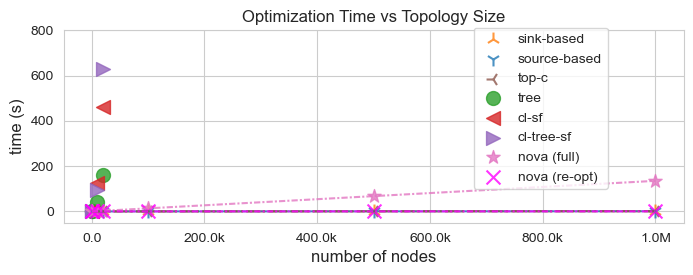

In [70]:
fig, ax = plt.subplots(figsize=(8, 2.5))

idx = 0
for k in approach_order + ["nova (re-opt)"]:
    if k == "nova":
        label = "nova (full)"
    else:
        label = k

    # create a scatter plot
    v = list(approaches[label].values())
    ax.scatter(topology_sizes, v, label=label, s=100, alpha=0.8, marker=markers[k], color=eval_colors[k])

    # calculate the linear regression line
    slope, intercept = np.polyfit(topology_sizes, v, 1)
    full_opt_line = np.poly1d((slope, intercept))(np.array(topology_sizes))
    # plot the linear regression line
    ax.plot(topology_sizes, full_opt_line, alpha=0.8, linestyle=styles[k], color=eval_colors[k], linewidth=1.5)
    idx += 1

# set the axis labels and title
ax.set_xlabel('number of nodes', fontsize=12)
ax.set_ylabel('time (s)', fontsize=12)

# Set the legend
ax.legend(loc='upper left', bbox_to_anchor=(0.65, 1.05))
ax.ticklabel_format(style='plain', axis='x')

# Set the x-ticks and format the tick labels
xticks = [100, 100000, 500000, 1000000]
xtick_labels = [f"{xtick // 1000}k" if xtick < 1000000 else f"{xtick // 1000000}M" for xtick in xticks]
#ax.set_xticks(xticks)
#ax.set_xticklabels(xtick_labels)

# Set the tick label format for the x-axis
formatter = FuncFormatter(lambda x, pos: f"{x}" if x < 1000 else f"{x // 1000}k" if x < 1000000 else f"{x // 1000000}M")
ax.xaxis.set_major_formatter(formatter)

ax.set_ylim([-50, 800])

plt.savefig("plots/scalability.svg", bbox_inches="tight")

# show the plot
plt.title('Optimization Time vs Topology Size')
plt.show()

## Re-Optimization

In [31]:
nova_add_sources_runtimes_dict = {100: np.float64(0.003950594000343699), 1000: np.float64(0.004131045998292393),
                                  10000: np.float64(0.005199297998842667), 20000: np.float64(0.006797576001190464),
                                  100000: np.float64(0.01772864899976412), 500000: np.float64(0.09750244399947405),
                                  1000000: np.float64(0.19904802400014887)}
nova_remove_sources_runtimes_dict = {100: np.float64(0.0011685429999488406), 1000: np.float64(0.0008933099998102989),
                                     10000: np.float64(0.0012646840004890691), 20000: np.float64(0.0015686179995100247),
                                     100000: np.float64(0.004214817001411575), 500000: np.float64(0.026117080999028985),
                                     1000000: np.float64(0.038443112000095425)}
nova_remove_parents_runtimes_dict = {100: np.float64(0.0015112170003703795), 1000: np.float64(0.006545594000272104),
                                     10000: np.float64(0.0028309110002737725), 20000: np.float64(0.012439170001016464),
                                     100000: np.float64(0.06675115800135245), 500000: np.float64(0.018856550001146388),
                                     1000000: np.float64(0.541834686000584)}
nova_update_coords_runtimes_dict = {100: np.float64(0.0033590279999771155), 1000: np.float64(0.003723650999745587),
                                    10000: np.float64(0.01125025700093829), 20000: np.float64(0.004024675999971805),
                                    100000: np.float64(0.015207851000013761), 500000: np.float64(0.013387918999796966),
                                    1000000: np.float64(0.008357942000657204)}

re_opt_order = {
    "add source": nova_add_sources_runtimes_dict,
    "remove sources": nova_remove_sources_runtimes_dict,
    "remove parents": nova_remove_parents_runtimes_dict,
    "update coords": nova_update_coords_runtimes_dict,
}

re_opt_dict = {}
for t_size in topology_sizes:
    tmp = []
    for k, v in re_opt_order.items():
        tmp.append(v[t_size])
    re_opt_dict[t_size] = np.mean(tmp)
print("re_opt_dict=", re_opt_dict)

re_opt_dict= {100: np.float64(0.0024973455001600087), 1000: np.float64(0.0038234002495300956), 10000: np.float64(0.00513628750013595), 20000: np.float64(0.0062075100004221895), 100000: np.float64(0.025975618750635476), 500000: np.float64(0.0389659984998616), 1000000: np.float64(0.19692094100037139)}


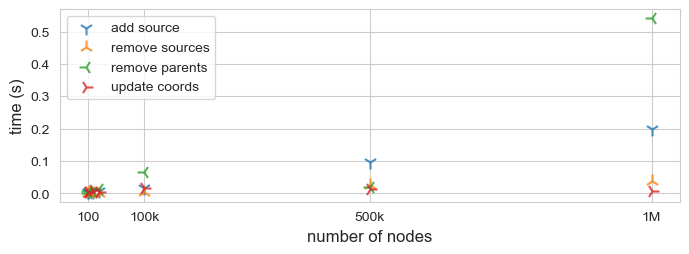

In [28]:
fig, ax = plt.subplots(figsize=(8, 2.5))
re_optimizations = []

idx = 1
for k, v in re_opt_order.items():
    v = list(v.values())
    # create a scatter plot
    ax.scatter(topology_sizes, v, label=k, s=100, alpha=0.8, marker=str(idx))

    # calculate the linear regression line
    slope, intercept = np.polyfit(topology_sizes, v, 1)
    full_opt_line = np.poly1d((slope, intercept))(np.array(topology_sizes))
    # plot the linear regression line
    #ax.plot(topology_sizes, full_opt_line, alpha=0.8, linestyle=styles[k], color=eval_colors[k], linewidth=1.5)
    idx += 1

# set the axis labels and title
ax.set_xlabel('number of nodes', fontsize=12)
ax.set_ylabel('time (s)', fontsize=12)

# Set the legend
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))
ax.ticklabel_format(style='plain', axis='x')

# Set the x-ticks and format the tick labels
xticks = [100, 100000, 500000, 1000000]
xtick_labels = [f"{xtick // 1000}k" if xtick < 1000000 else f"{xtick // 1000000}M" for xtick in xticks]
ax.set_xticks(xticks)
ax.set_xticklabels(xtick_labels)

# Set the tick label format for the x-axis
formatter = FuncFormatter(lambda x, pos: f"{x}" if x < 1000 else f"{x // 1000}k" if x < 1000000 else f"{x // 1000000}M")
ax.xaxis.set_major_formatter(formatter)

#ax.set_xlim([-0.05, 110000])
#ax.set_ylim([-1, 25])
ax.legend()

plt.savefig("plots/nova_re-optimization.svg", bbox_inches="tight")
plt.show()